In [1]:
import tensorflow as tf
sess = tf.Session()

In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="2"

In [3]:
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from __future__ import print_function
import keras
from keras.utils import to_categorical
import os
from keras.preprocessing.image import ImageDataGenerator, load_img
from keras.applications.inception_v3 import InceptionV3, preprocess_input
from sklearn.metrics import confusion_matrix
from keras.layers.core import Flatten, Dense, Dropout, Reshape, Lambda
from keras.layers.normalization import BatchNormalization
from keras.models import Model

Using TensorFlow backend.


In [4]:
from keras.applications import VGG19

vgg_conv = VGG19(weights='imagenet',
                  include_top=False,
                  input_shape=(200, 200, 3))

In [5]:
vgg_conv.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 200, 200, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 200, 200, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 200, 200, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 100, 100, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 100, 100, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 100, 100, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 50, 50, 128)       0         
__________

In [6]:
train_dir = './train_kg'
validation_dir = './validation_kg'

classes = os.listdir(train_dir)
print (classes)
nTrain_data= []
nVal_data = []
train_labels=[]
val_labels=[]
for c in classes:
    t = [c]*len(os.listdir(train_dir+'/'+c+'/'))
    v = [c]*len(os.listdir(validation_dir+'/'+c+'/'))
    nTrain_data.extend(t)
    nVal_data.extend(v)
    train_labels.append(len(os.listdir(train_dir+'/'+c)))
    val_labels.append(len(os.listdir(validation_dir+'/'+c)))

nTrain = len(nTrain_data)
nVal = len(nVal_data)
print (nTrain)
print (nVal)


['YFT', 'OTHER', 'LAG', 'DOL', 'ALB', 'SHARK', 'BET']
2647
665


In [7]:
datagen = ImageDataGenerator(rotation_range=60,rescale=1./255,shear_range=0.2,width_shift_range=0.2,height_shift_range=0.2,zoom_range=0.1,horizontal_flip=True)
batch_size = 10

train_features = np.zeros(shape=(nTrain, 6, 6, 512))
train_labels = np.zeros(shape=(nTrain,7))

train_generator = datagen.flow_from_directory(
    train_dir,
    target_size=(200, 200),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=True)

Found 2647 images belonging to 7 classes.


In [8]:
i = 0
for inputs_batch, labels_batch in train_generator:
    features_batch = vgg_conv.predict(inputs_batch)
    train_features[i * batch_size : (i + 1) * batch_size] = features_batch
    train_labels[i * batch_size : (i + 1) * batch_size] = labels_batch
    i += 1
    if i * batch_size >= nTrain:
        break
train_features = np.reshape(train_features, (nTrain, 6 * 6 * 512))

In [9]:
validation_features = np.zeros(shape=(nVal, 6, 6, 512))
validation_labels = np.zeros(shape=(nVal,7))

validation_generator = datagen.flow_from_directory(
    validation_dir,
    target_size=(200, 200),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False)

i = 0
for inputs_batch, labels_batch in validation_generator:
    features_batch = vgg_conv.predict(inputs_batch)
    validation_features[i * batch_size : (i + 1) * batch_size] = features_batch
    validation_labels[i * batch_size : (i + 1) * batch_size] = labels_batch
    i += 1
    if i * batch_size >= nVal:
        break

validation_features = np.reshape(validation_features, (nVal, 6 * 6 * 512))

Found 665 images belonging to 7 classes.


In [11]:
from keras import models
from keras import layers
from keras import optimizers
from keras.layers.convolutional import Convolution2D, MaxPooling2D, ZeroPadding2D, AveragePooling2D
from keras.models import Sequential

print('Adding new layers...')
# output = vgg_conv.get_layer(index = -1).output  
# output = Flatten()(output)
# # let's add a fully-connected layer
# output = Dense(4096,activation = "relu")(output)
# output = BatchNormalization()(output)
# output = Dropout(0.5)(output)
# output = Dense(512,activation = "relu")(output)
# output = BatchNormalization()(output)
# output = Dropout(0.5)(output)
# # and a logistic layer -- let's say we have 200 classes
# output = Dense(8, activation='softmax')(output)


# vgg19_model = Model(vgg_conv.input, output)

# model = models.Sequential()
# model.add(layers.Dense(1024, activation='relu', input_dim=6 * 6 * 512))
# model.add(layers.Dropout(0.5))
# model.add(layers.Dense(64, activation='relu'))
# model.add(layers.Dropout(0.5))
# model.add(layers.Dense(7, activation='softmax'))

model = Sequential()
#model.add(Flatten(input_shape=train_features.shape[1:]))
model.add(Dense(4096, activation='relu',input_dim=6 * 6 * 512))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(512, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.3))
model.add(Dense(7, activation='softmax'))

for layer in vgg_conv.layers[:10]:
    layer.trainable = False
    
model.compile(optimizer=optimizers.RMSprop(lr=2e-4),
              loss='categorical_crossentropy',
              metrics=['acc'])

history = model.fit(train_features,train_labels,epochs=20,batch_size=batch_size,validation_data=(validation_features,validation_labels))

Adding new layers...
Train on 2647 samples, validate on 665 samples
Epoch 1/20
2647/2647 [==============================] - 22s - loss: 2.1887 - acc: 0.3952 - val_loss: 1.5697 - val_acc: 0.5774
Epoch 2/20
2647/2647 [==============================] - 21s - loss: 1.1552 - acc: 0.6320 - val_loss: 1.3628 - val_acc: 0.6466
Epoch 3/20
2647/2647 [==============================] - 21s - loss: 0.7474 - acc: 0.7624 - val_loss: 1.4435 - val_acc: 0.6421
Epoch 4/20
2647/2647 [==============================] - 21s - loss: 0.5310 - acc: 0.8209 - val_loss: 1.7501 - val_acc: 0.5925
Epoch 5/20
2647/2647 [==============================] - 21s - loss: 0.4047 - acc: 0.8648 - val_loss: 1.4393 - val_acc: 0.6346
Epoch 6/20
2647/2647 [==============================] - 21s - loss: 0.3020 - acc: 0.8965 - val_loss: 1.4312 - val_acc: 0.6496
Epoch 7/20
2647/2647 [==============================] - 21s - loss: 0.2365 - acc: 0.9214 - val_loss: 1.5097 - val_acc: 0.6541
Epoch 8/20
2647/2647 [============================

In [12]:
fnames = validation_generator.filenames
ground_truth = validation_generator.classes
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.iteritems())

In [13]:
predictions = model.predict_classes(validation_features)
prob = model.predict(validation_features)

544/665 [=======================>......] - ETA: 0s

In [14]:
errors = np.where(predictions != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),nVal))

No of errors = 239/665


Original label:ALB, Prediction :SHARK, confidence : 0.981


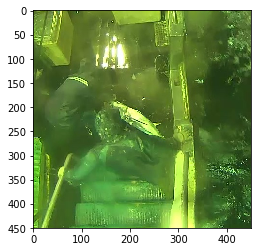

Original label:ALB, Prediction :OTHER, confidence : 0.827


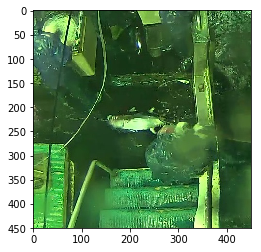

Original label:ALB, Prediction :OTHER, confidence : 0.653


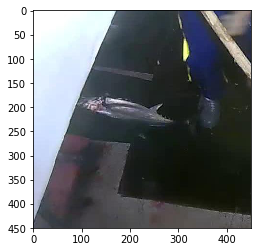

Original label:ALB, Prediction :YFT, confidence : 0.884


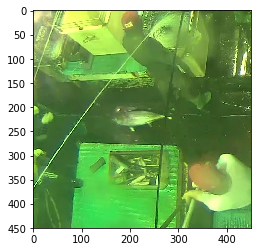

Original label:ALB, Prediction :BET, confidence : 0.985


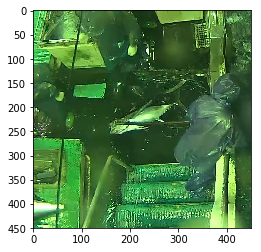

Original label:ALB, Prediction :OTHER, confidence : 0.917


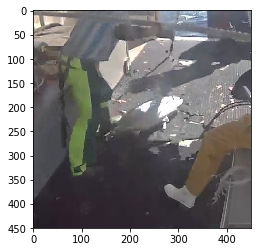

Original label:ALB, Prediction :OTHER, confidence : 0.931


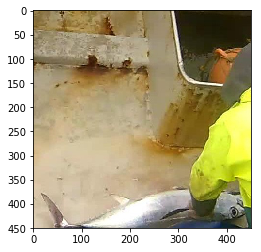

Original label:ALB, Prediction :DOL, confidence : 0.534


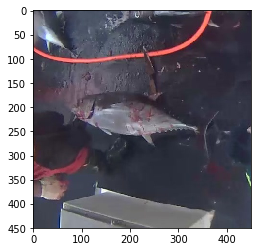

Original label:ALB, Prediction :OTHER, confidence : 0.462


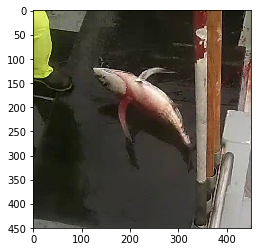

Original label:ALB, Prediction :SHARK, confidence : 0.999


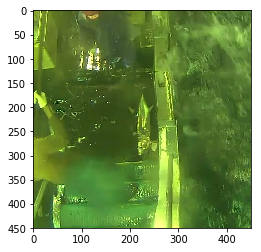

Original label:ALB, Prediction :BET, confidence : 0.963


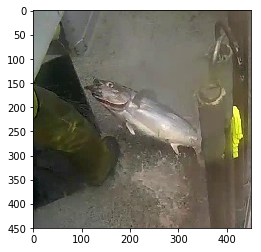

Original label:ALB, Prediction :YFT, confidence : 0.642


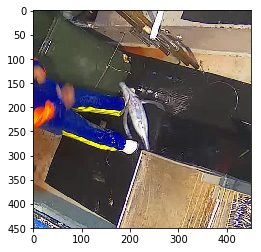

Original label:ALB, Prediction :OTHER, confidence : 0.912


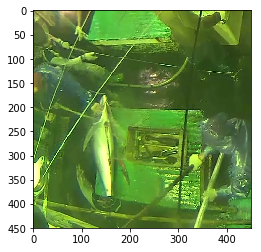

Original label:ALB, Prediction :OTHER, confidence : 0.844


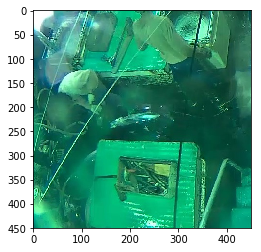

Original label:ALB, Prediction :OTHER, confidence : 0.809


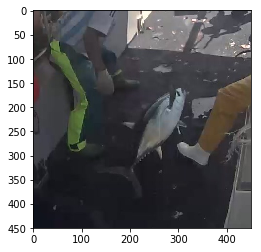

Original label:ALB, Prediction :OTHER, confidence : 0.993


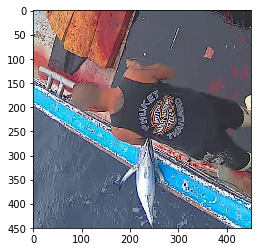

Original label:ALB, Prediction :OTHER, confidence : 0.479


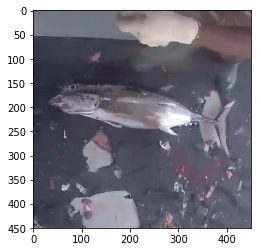

Original label:ALB, Prediction :YFT, confidence : 1.000


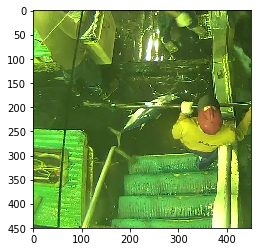

Original label:ALB, Prediction :OTHER, confidence : 0.996


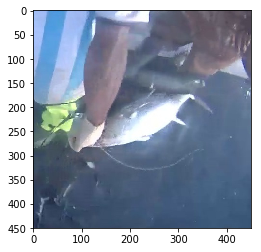

Original label:ALB, Prediction :OTHER, confidence : 0.690


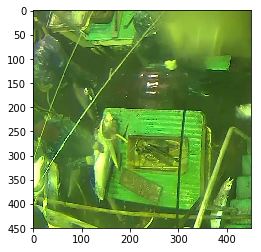

Original label:ALB, Prediction :OTHER, confidence : 0.625


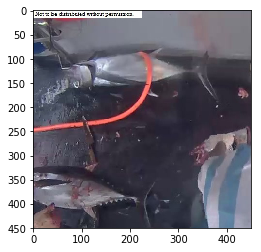

Original label:ALB, Prediction :OTHER, confidence : 0.994


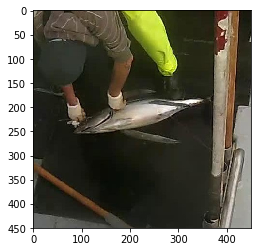

Original label:ALB, Prediction :OTHER, confidence : 0.865


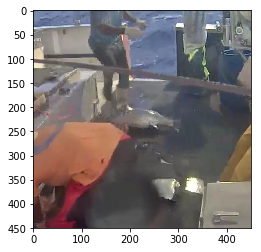

Original label:ALB, Prediction :OTHER, confidence : 0.899


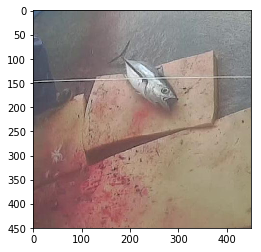

Original label:ALB, Prediction :OTHER, confidence : 0.885


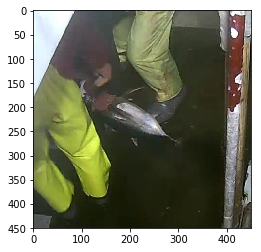

Original label:ALB, Prediction :OTHER, confidence : 0.944


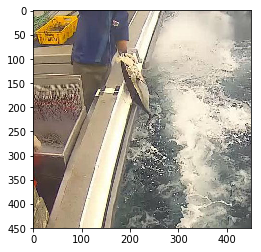

Original label:ALB, Prediction :YFT, confidence : 0.799


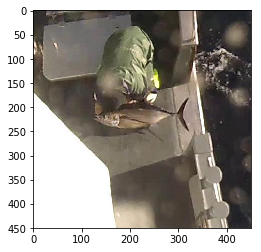

Original label:ALB, Prediction :YFT, confidence : 0.987


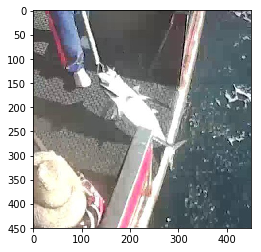

Original label:ALB, Prediction :OTHER, confidence : 0.596


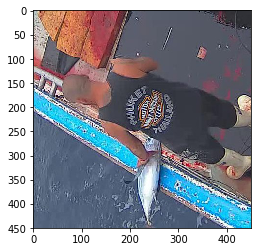

Original label:ALB, Prediction :BET, confidence : 0.628


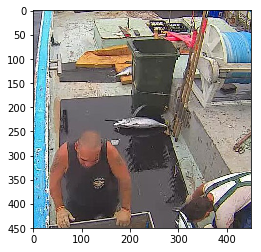

Original label:ALB, Prediction :OTHER, confidence : 0.652


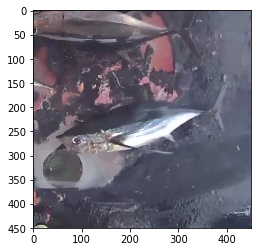

Original label:ALB, Prediction :OTHER, confidence : 0.995


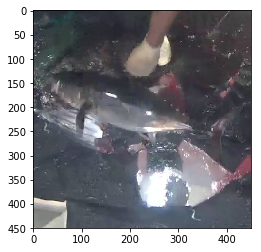

Original label:ALB, Prediction :OTHER, confidence : 0.999


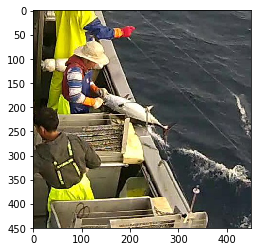

Original label:ALB, Prediction :OTHER, confidence : 0.981


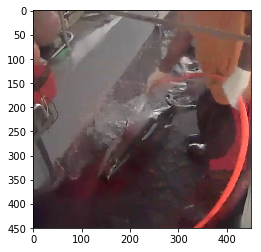

Original label:ALB, Prediction :OTHER, confidence : 0.990


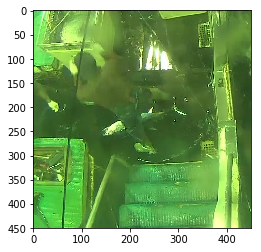

Original label:ALB, Prediction :OTHER, confidence : 0.983


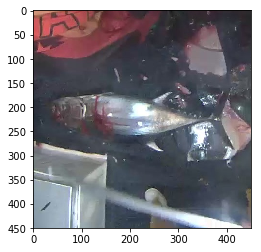

Original label:ALB, Prediction :YFT, confidence : 0.531


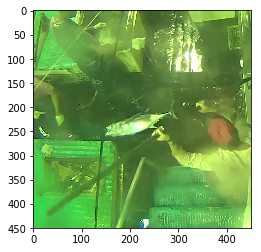

Original label:ALB, Prediction :OTHER, confidence : 0.722


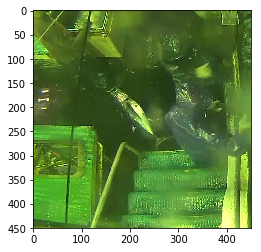

Original label:ALB, Prediction :SHARK, confidence : 0.805


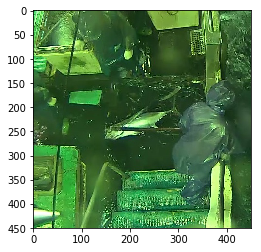

Original label:ALB, Prediction :OTHER, confidence : 0.995


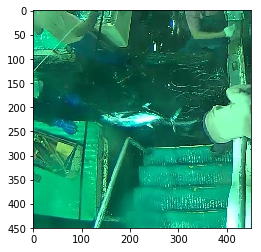

Original label:ALB, Prediction :OTHER, confidence : 0.999


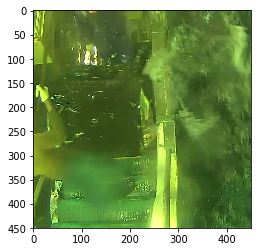

Original label:ALB, Prediction :BET, confidence : 0.832


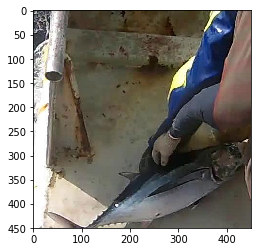

Original label:ALB, Prediction :BET, confidence : 0.957


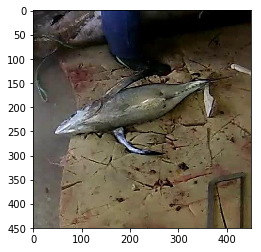

Original label:ALB, Prediction :OTHER, confidence : 0.838


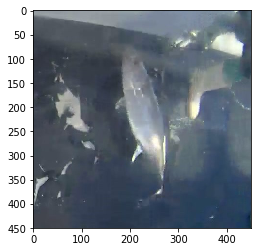

Original label:ALB, Prediction :OTHER, confidence : 0.556


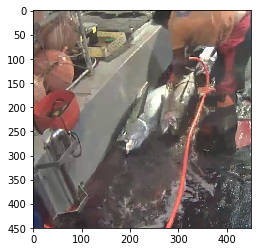

Original label:ALB, Prediction :OTHER, confidence : 0.939


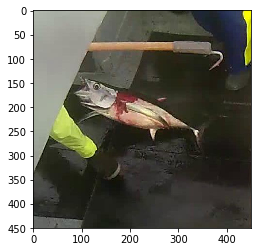

Original label:ALB, Prediction :OTHER, confidence : 0.820


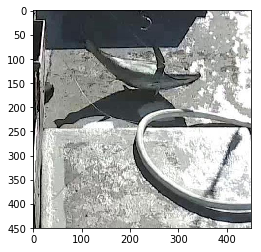

Original label:ALB, Prediction :OTHER, confidence : 0.967


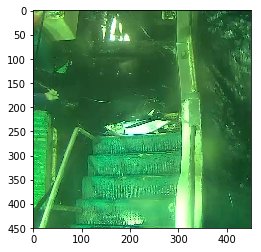

Original label:ALB, Prediction :OTHER, confidence : 0.785


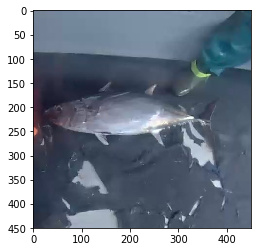

Original label:ALB, Prediction :OTHER, confidence : 0.540


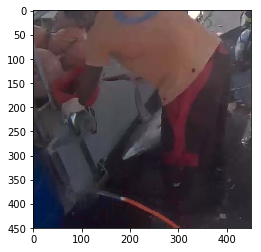

Original label:ALB, Prediction :BET, confidence : 0.575


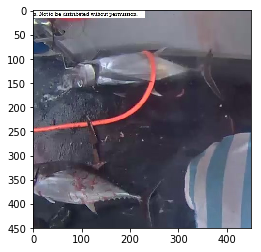

Original label:ALB, Prediction :OTHER, confidence : 0.980


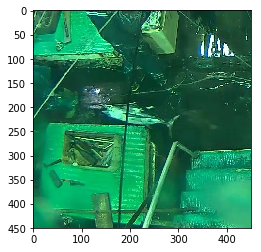

Original label:ALB, Prediction :OTHER, confidence : 0.524


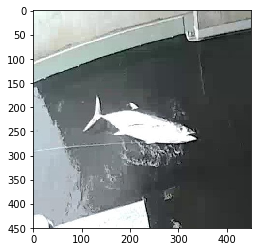

Original label:ALB, Prediction :OTHER, confidence : 0.856


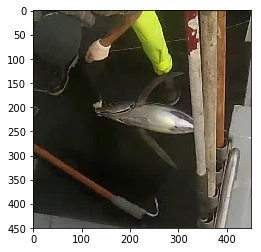

Original label:ALB, Prediction :OTHER, confidence : 0.795


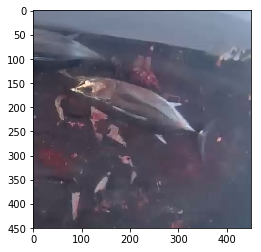

Original label:ALB, Prediction :BET, confidence : 0.709


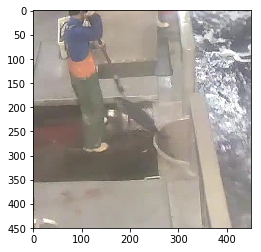

Original label:ALB, Prediction :OTHER, confidence : 0.386


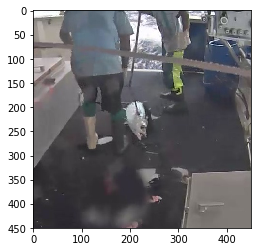

Original label:ALB, Prediction :SHARK, confidence : 0.733


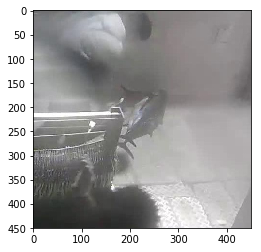

Original label:ALB, Prediction :OTHER, confidence : 0.930


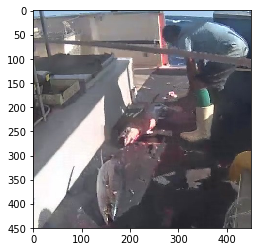

Original label:ALB, Prediction :OTHER, confidence : 0.511


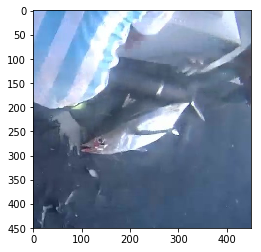

Original label:ALB, Prediction :OTHER, confidence : 0.540


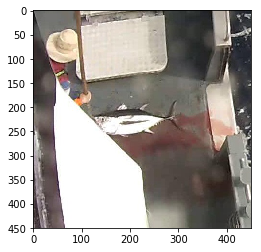

Original label:ALB, Prediction :SHARK, confidence : 0.982


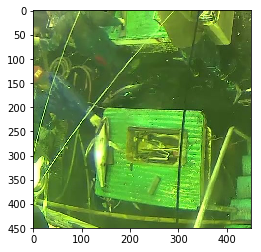

Original label:ALB, Prediction :OTHER, confidence : 0.843


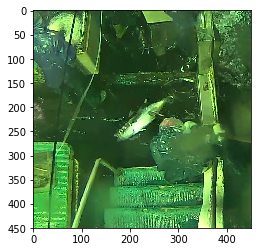

Original label:ALB, Prediction :SHARK, confidence : 0.994


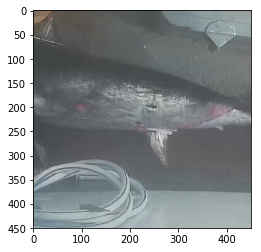

Original label:ALB, Prediction :OTHER, confidence : 0.746


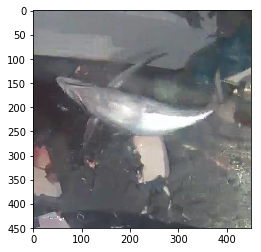

Original label:ALB, Prediction :OTHER, confidence : 0.706


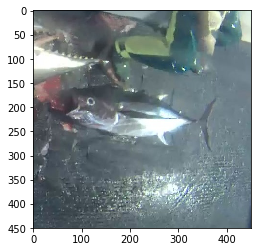

Original label:ALB, Prediction :YFT, confidence : 0.901


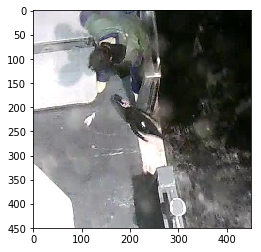

Original label:ALB, Prediction :OTHER, confidence : 0.952


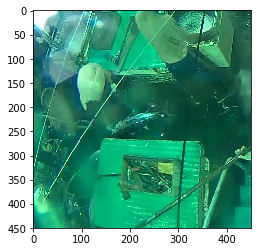

Original label:ALB, Prediction :BET, confidence : 0.445


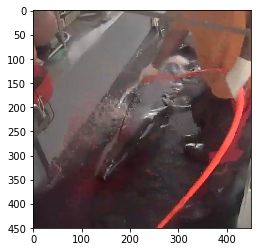

Original label:ALB, Prediction :SHARK, confidence : 0.616


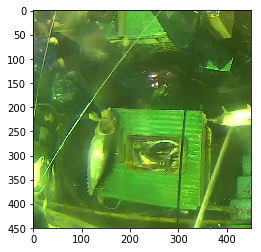

Original label:ALB, Prediction :YFT, confidence : 0.786


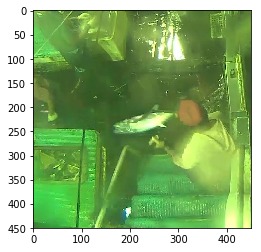

Original label:ALB, Prediction :OTHER, confidence : 0.917


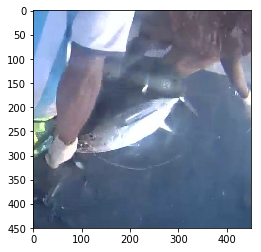

Original label:ALB, Prediction :OTHER, confidence : 0.538


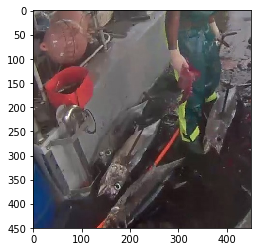

Original label:ALB, Prediction :OTHER, confidence : 1.000


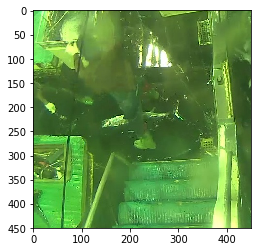

Original label:ALB, Prediction :OTHER, confidence : 0.526


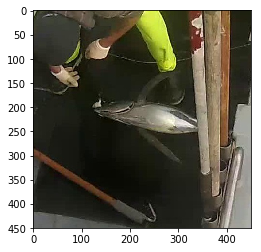

Original label:ALB, Prediction :SHARK, confidence : 0.979


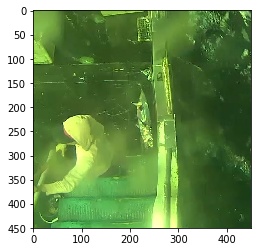

Original label:ALB, Prediction :OTHER, confidence : 0.994


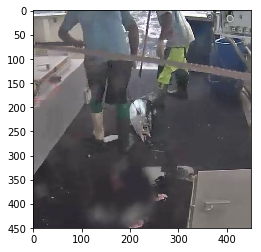

Original label:ALB, Prediction :OTHER, confidence : 0.838


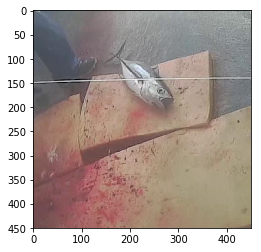

Original label:ALB, Prediction :OTHER, confidence : 0.851


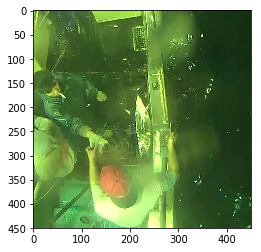

Original label:ALB, Prediction :OTHER, confidence : 0.681


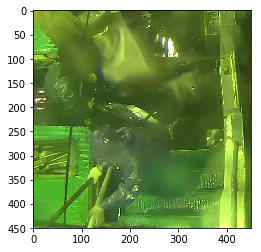

Original label:ALB, Prediction :YFT, confidence : 1.000


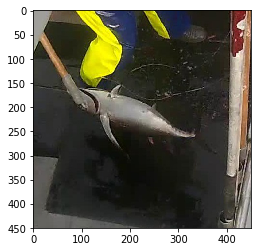

Original label:ALB, Prediction :OTHER, confidence : 0.993


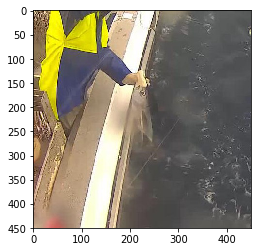

Original label:ALB, Prediction :OTHER, confidence : 0.821


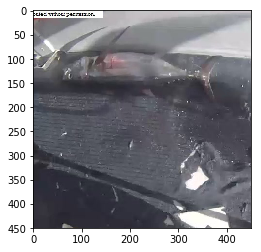

Original label:ALB, Prediction :YFT, confidence : 0.990


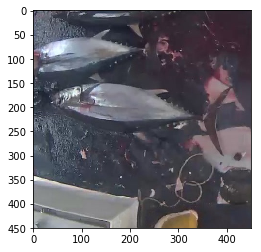

Original label:ALB, Prediction :OTHER, confidence : 0.658


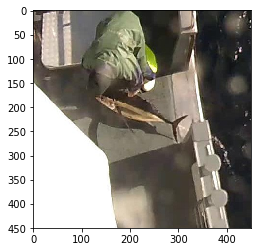

Original label:ALB, Prediction :SHARK, confidence : 0.859


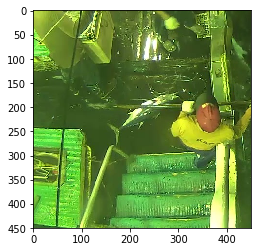

Original label:ALB, Prediction :DOL, confidence : 0.466


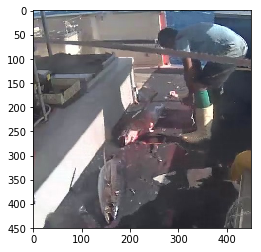

Original label:ALB, Prediction :OTHER, confidence : 0.986


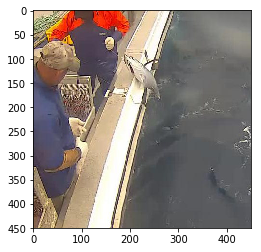

Original label:ALB, Prediction :BET, confidence : 0.975


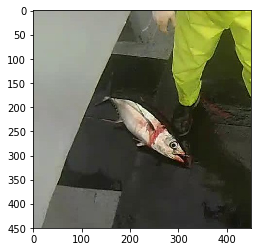

Original label:ALB, Prediction :YFT, confidence : 0.352


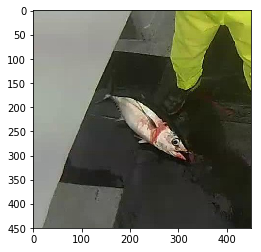

Original label:ALB, Prediction :SHARK, confidence : 0.966


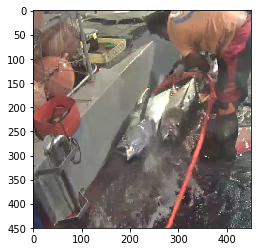

Original label:ALB, Prediction :OTHER, confidence : 0.993


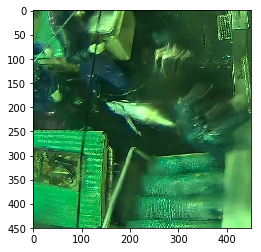

Original label:ALB, Prediction :OTHER, confidence : 0.885


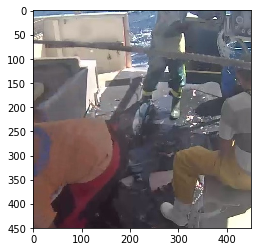

Original label:ALB, Prediction :YFT, confidence : 0.646


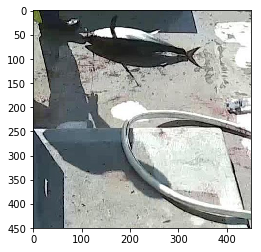

Original label:ALB, Prediction :DOL, confidence : 0.488


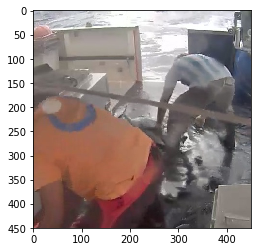

Original label:ALB, Prediction :SHARK, confidence : 0.621


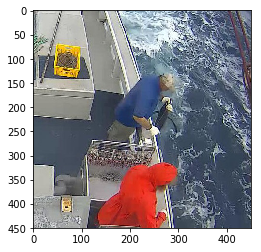

Original label:ALB, Prediction :OTHER, confidence : 0.931


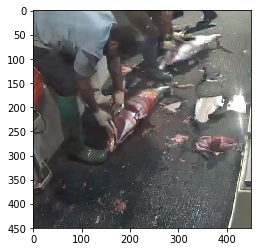

Original label:ALB, Prediction :OTHER, confidence : 0.548


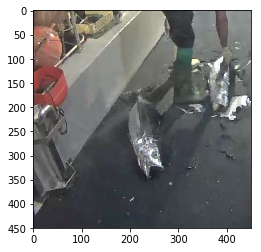

Original label:ALB, Prediction :OTHER, confidence : 0.671


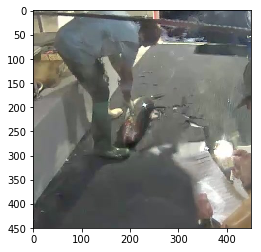

Original label:ALB, Prediction :DOL, confidence : 0.959


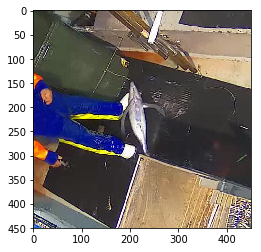

Original label:ALB, Prediction :YFT, confidence : 0.740


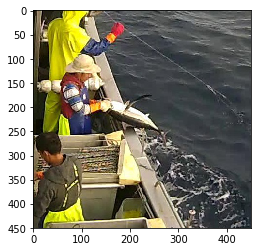

Original label:ALB, Prediction :YFT, confidence : 0.887


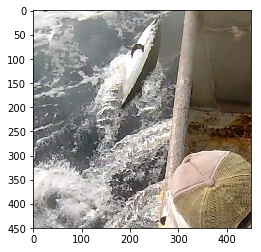

Original label:ALB, Prediction :OTHER, confidence : 0.984


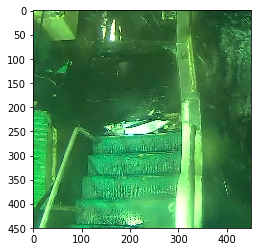

Original label:ALB, Prediction :SHARK, confidence : 0.966


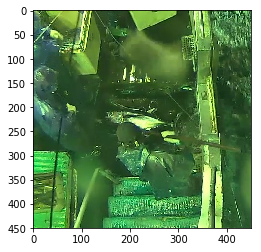

Original label:ALB, Prediction :OTHER, confidence : 0.656


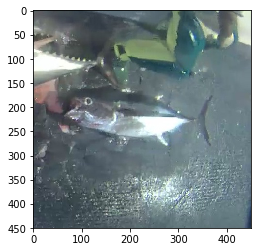

Original label:ALB, Prediction :OTHER, confidence : 0.989


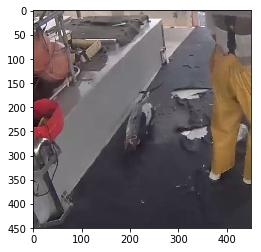

Original label:BET, Prediction :OTHER, confidence : 0.945


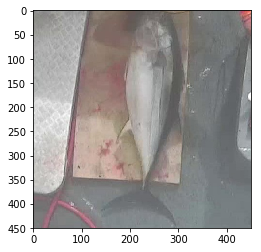

Original label:BET, Prediction :DOL, confidence : 0.829


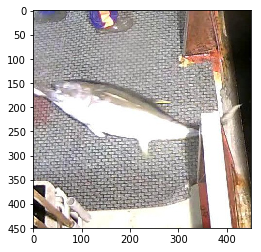

Original label:BET, Prediction :DOL, confidence : 0.600


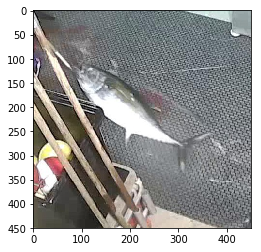

Original label:BET, Prediction :OTHER, confidence : 0.440


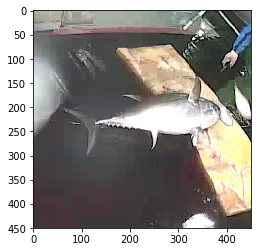

Original label:BET, Prediction :YFT, confidence : 1.000


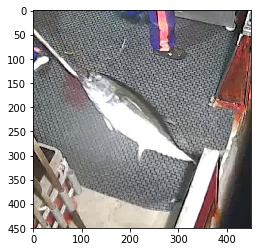

Original label:BET, Prediction :OTHER, confidence : 0.704


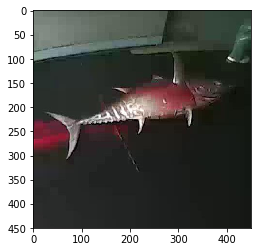

Original label:BET, Prediction :YFT, confidence : 0.997


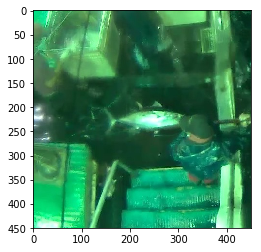

Original label:BET, Prediction :ALB, confidence : 0.983


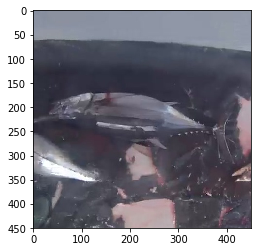

Original label:BET, Prediction :ALB, confidence : 0.996


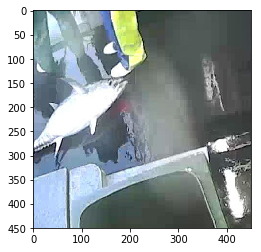

Original label:BET, Prediction :YFT, confidence : 0.579


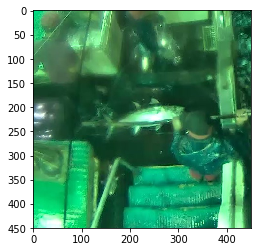

Original label:BET, Prediction :SHARK, confidence : 0.828


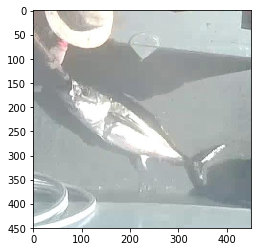

Original label:BET, Prediction :ALB, confidence : 0.775


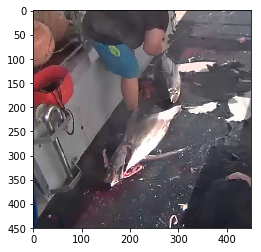

Original label:BET, Prediction :OTHER, confidence : 0.861


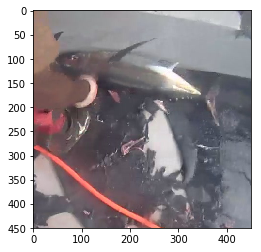

Original label:BET, Prediction :OTHER, confidence : 0.842


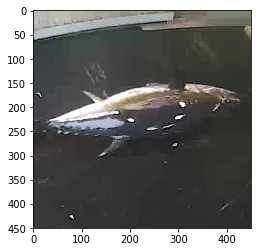

Original label:BET, Prediction :YFT, confidence : 0.858


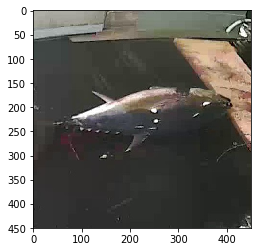

Original label:BET, Prediction :OTHER, confidence : 0.641


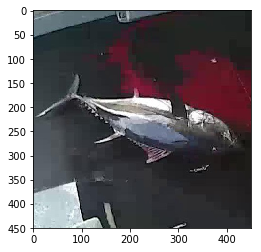

Original label:BET, Prediction :YFT, confidence : 0.768


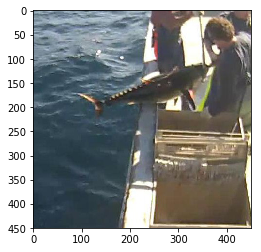

Original label:BET, Prediction :SHARK, confidence : 0.558


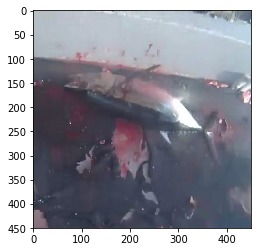

Original label:BET, Prediction :ALB, confidence : 0.972


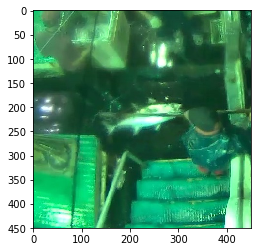

Original label:BET, Prediction :ALB, confidence : 0.701


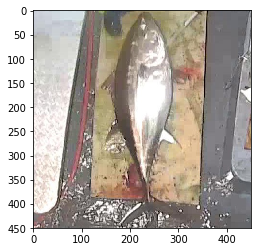

Original label:BET, Prediction :ALB, confidence : 0.843


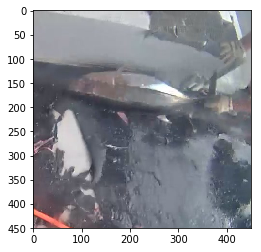

Original label:BET, Prediction :ALB, confidence : 0.989


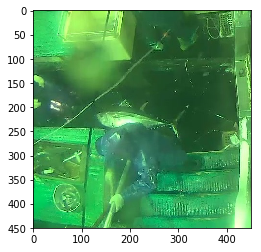

Original label:BET, Prediction :OTHER, confidence : 0.678


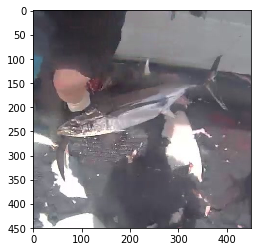

Original label:BET, Prediction :ALB, confidence : 0.944


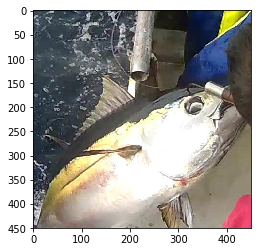

Original label:BET, Prediction :YFT, confidence : 0.943


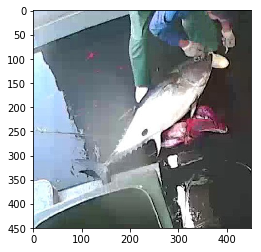

Original label:BET, Prediction :OTHER, confidence : 0.997


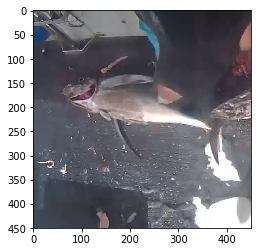

Original label:BET, Prediction :YFT, confidence : 0.979


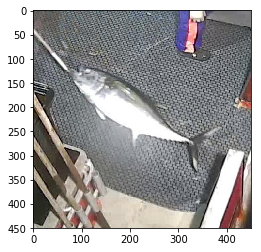

Original label:BET, Prediction :ALB, confidence : 1.000


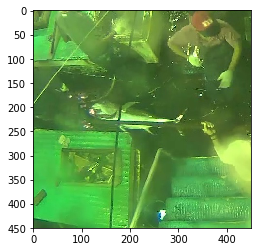

Original label:BET, Prediction :OTHER, confidence : 0.999


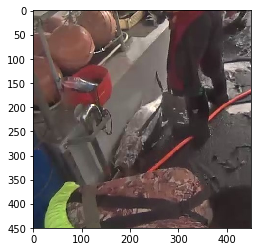

Original label:DOL, Prediction :ALB, confidence : 0.835


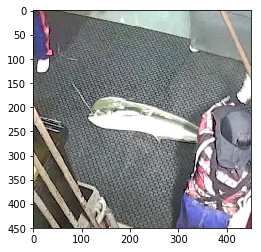

Original label:DOL, Prediction :ALB, confidence : 0.382


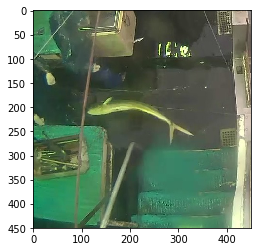

Original label:DOL, Prediction :OTHER, confidence : 0.999


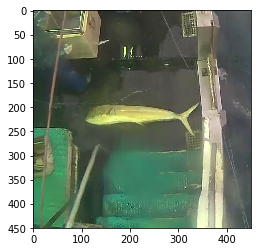

Original label:DOL, Prediction :OTHER, confidence : 0.556


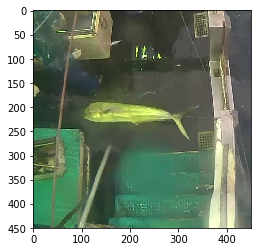

Original label:DOL, Prediction :OTHER, confidence : 0.948


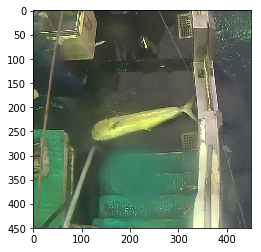

Original label:DOL, Prediction :ALB, confidence : 0.628


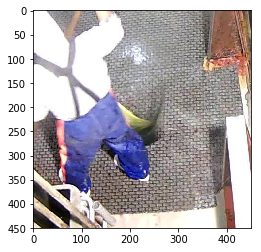

Original label:DOL, Prediction :BET, confidence : 0.954


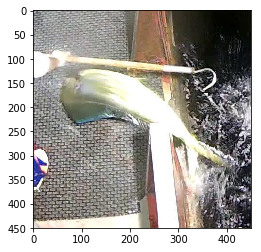

Original label:DOL, Prediction :ALB, confidence : 0.999


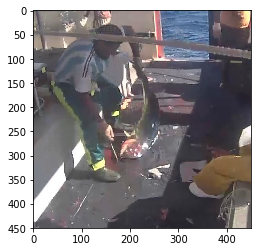

Original label:DOL, Prediction :ALB, confidence : 0.984


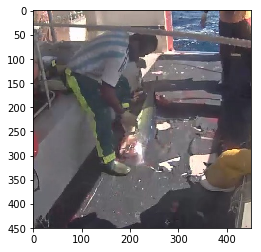

Original label:DOL, Prediction :SHARK, confidence : 0.770


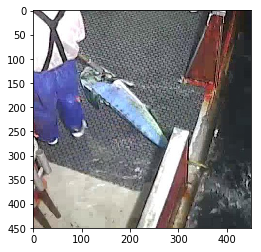

Original label:DOL, Prediction :OTHER, confidence : 0.882


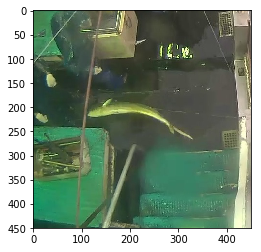

Original label:DOL, Prediction :OTHER, confidence : 0.997


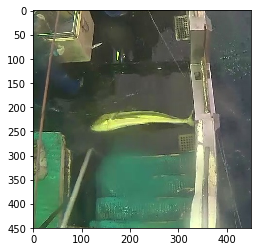

Original label:LAG, Prediction :OTHER, confidence : 0.853


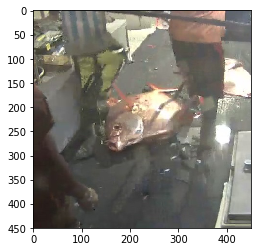

Original label:LAG, Prediction :OTHER, confidence : 0.992


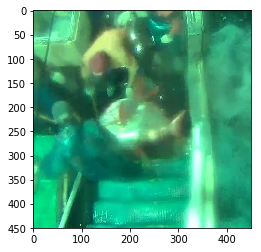

Original label:LAG, Prediction :ALB, confidence : 0.410


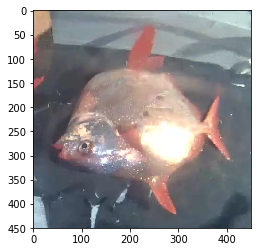

Original label:LAG, Prediction :ALB, confidence : 0.667


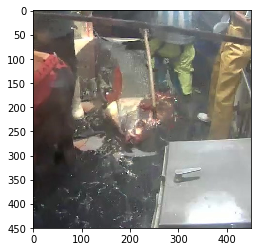

Original label:LAG, Prediction :SHARK, confidence : 0.667


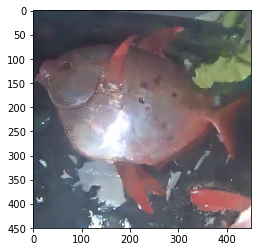

Original label:LAG, Prediction :ALB, confidence : 0.987


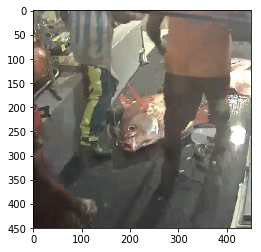

Original label:LAG, Prediction :ALB, confidence : 0.999


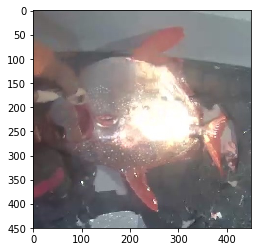

Original label:OTHER, Prediction :ALB, confidence : 0.846


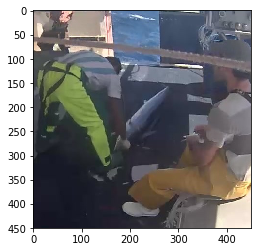

Original label:OTHER, Prediction :ALB, confidence : 0.557


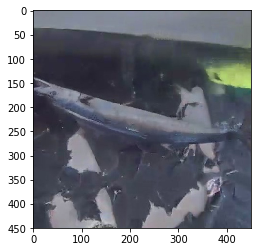

Original label:OTHER, Prediction :ALB, confidence : 0.964


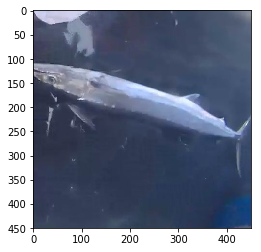

Original label:OTHER, Prediction :ALB, confidence : 0.762


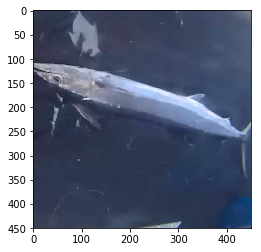

Original label:OTHER, Prediction :ALB, confidence : 0.999


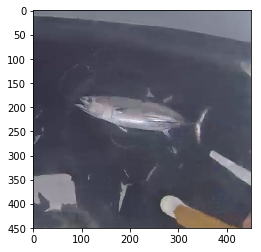

Original label:OTHER, Prediction :YFT, confidence : 0.612


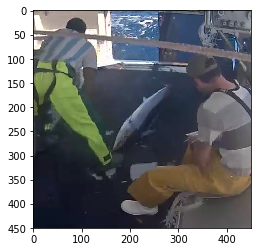

Original label:OTHER, Prediction :ALB, confidence : 0.990


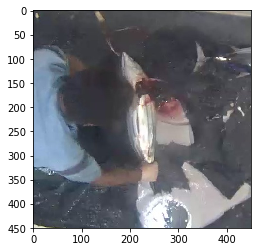

Original label:OTHER, Prediction :ALB, confidence : 0.993


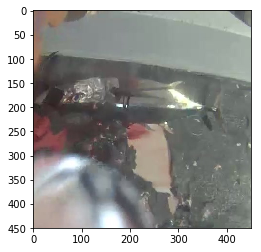

Original label:OTHER, Prediction :ALB, confidence : 0.857


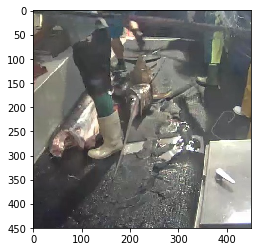

Original label:OTHER, Prediction :ALB, confidence : 0.801


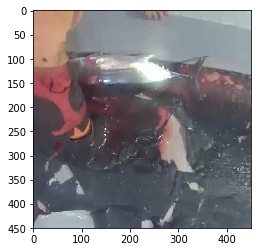

Original label:OTHER, Prediction :BET, confidence : 0.560


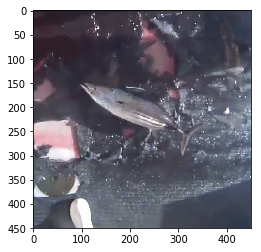

Original label:OTHER, Prediction :ALB, confidence : 0.895


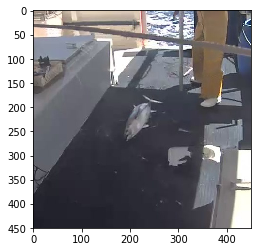

Original label:OTHER, Prediction :SHARK, confidence : 0.636


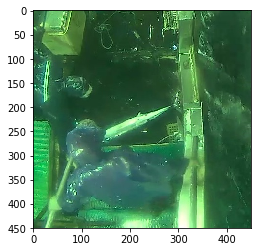

Original label:OTHER, Prediction :ALB, confidence : 0.938


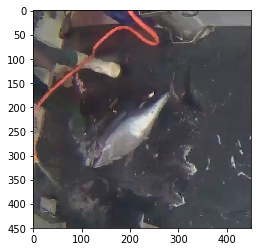

Original label:OTHER, Prediction :ALB, confidence : 0.301


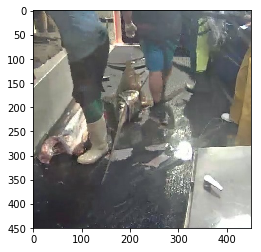

Original label:OTHER, Prediction :ALB, confidence : 1.000


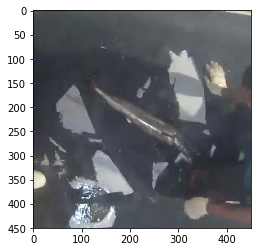

Original label:OTHER, Prediction :ALB, confidence : 0.789


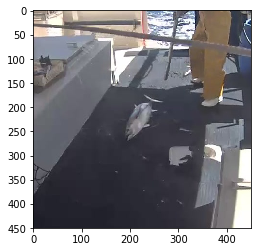

Original label:SHARK, Prediction :OTHER, confidence : 0.900


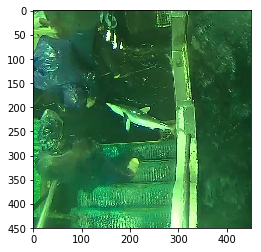

Original label:SHARK, Prediction :ALB, confidence : 0.824


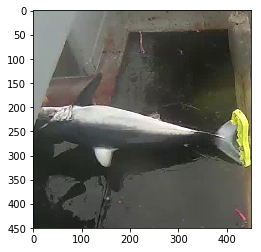

Original label:SHARK, Prediction :OTHER, confidence : 0.891


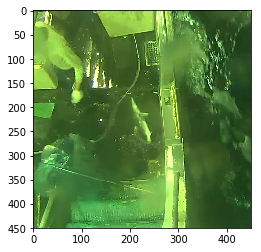

Original label:SHARK, Prediction :ALB, confidence : 0.542


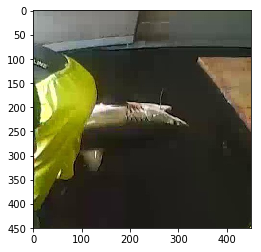

Original label:SHARK, Prediction :YFT, confidence : 0.521


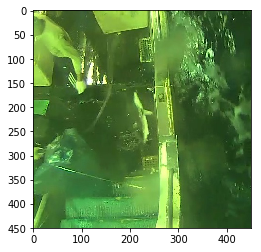

Original label:SHARK, Prediction :YFT, confidence : 0.979


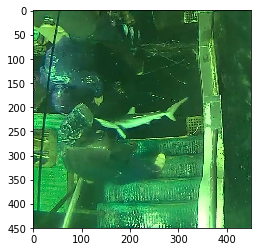

Original label:SHARK, Prediction :OTHER, confidence : 0.566


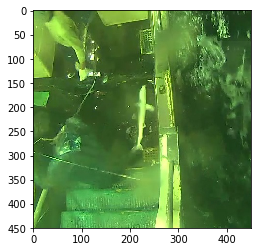

Original label:SHARK, Prediction :OTHER, confidence : 0.661


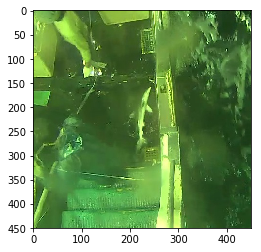

Original label:SHARK, Prediction :OTHER, confidence : 0.963


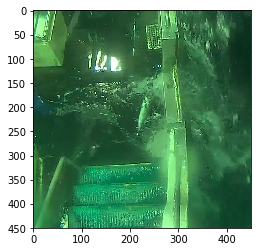

Original label:SHARK, Prediction :OTHER, confidence : 0.440


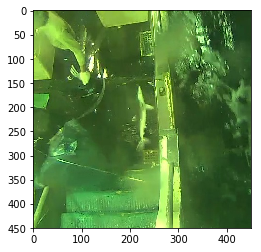

Original label:YFT, Prediction :ALB, confidence : 0.701


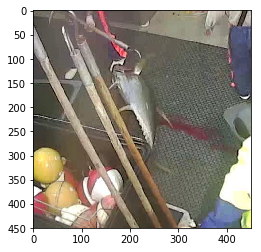

Original label:YFT, Prediction :ALB, confidence : 0.994


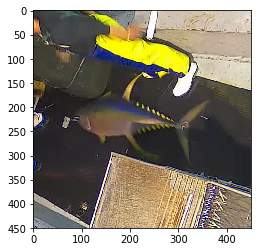

Original label:YFT, Prediction :ALB, confidence : 0.996


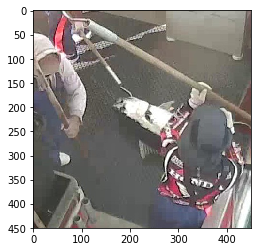

Original label:YFT, Prediction :OTHER, confidence : 0.745


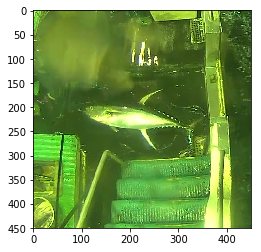

Original label:YFT, Prediction :LAG, confidence : 0.733


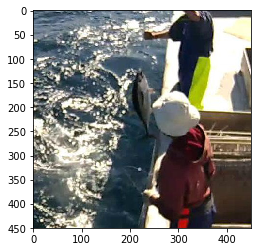

Original label:YFT, Prediction :ALB, confidence : 0.968


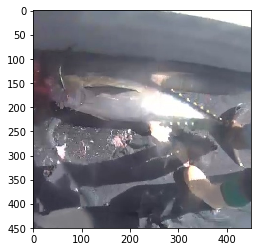

Original label:YFT, Prediction :OTHER, confidence : 0.914


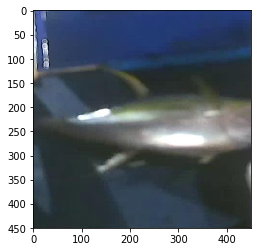

Original label:YFT, Prediction :SHARK, confidence : 0.494


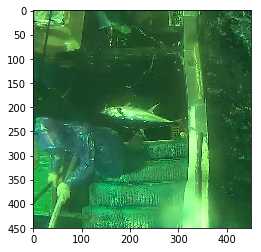

Original label:YFT, Prediction :OTHER, confidence : 0.577


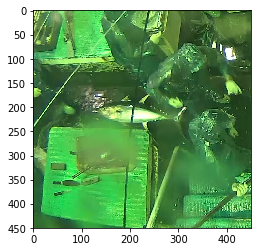

Original label:YFT, Prediction :ALB, confidence : 0.666


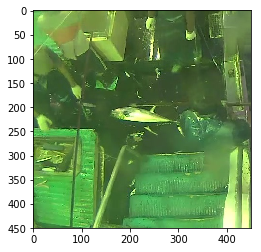

Original label:YFT, Prediction :SHARK, confidence : 0.453


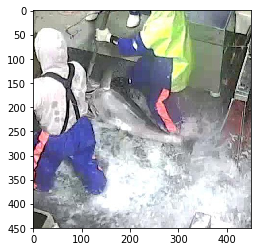

Original label:YFT, Prediction :ALB, confidence : 0.618


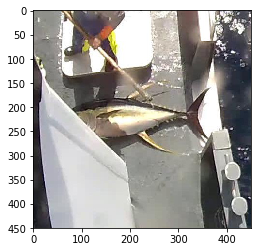

Original label:YFT, Prediction :ALB, confidence : 0.741


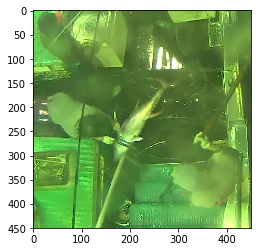

Original label:YFT, Prediction :OTHER, confidence : 0.854


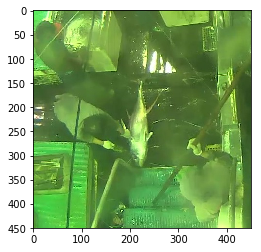

Original label:YFT, Prediction :OTHER, confidence : 0.767


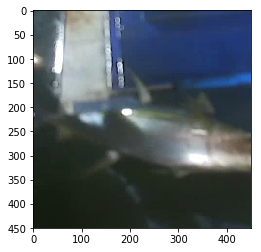

Original label:YFT, Prediction :ALB, confidence : 0.913


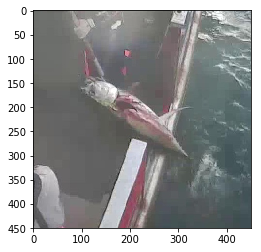

Original label:YFT, Prediction :ALB, confidence : 0.981


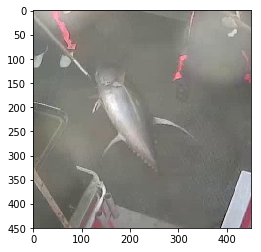

Original label:YFT, Prediction :ALB, confidence : 0.878


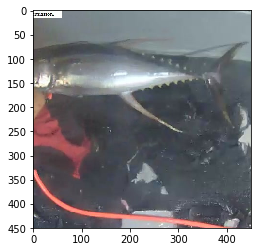

Original label:YFT, Prediction :OTHER, confidence : 0.826


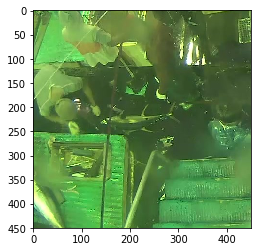

Original label:YFT, Prediction :OTHER, confidence : 0.996


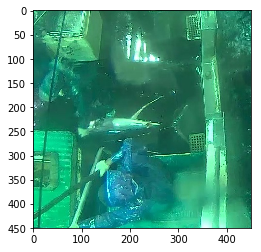

Original label:YFT, Prediction :OTHER, confidence : 0.488


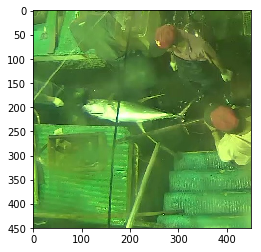

Original label:YFT, Prediction :BET, confidence : 0.406


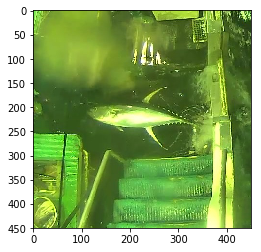

Original label:YFT, Prediction :OTHER, confidence : 0.748


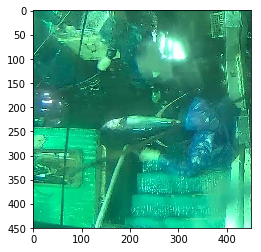

Original label:YFT, Prediction :OTHER, confidence : 0.998


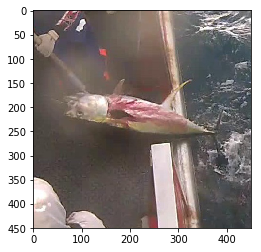

Original label:YFT, Prediction :ALB, confidence : 0.998


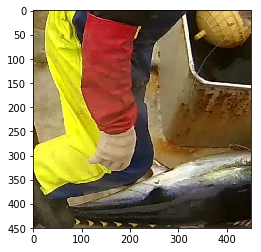

Original label:YFT, Prediction :DOL, confidence : 0.681


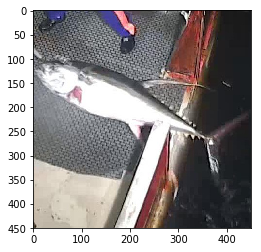

Original label:YFT, Prediction :OTHER, confidence : 0.957


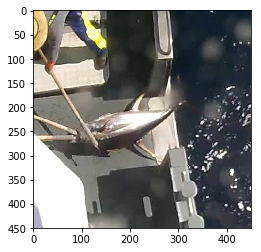

Original label:YFT, Prediction :ALB, confidence : 0.996


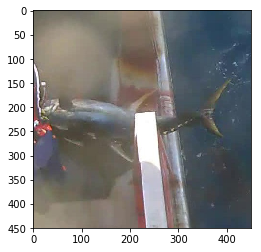

Original label:YFT, Prediction :ALB, confidence : 0.941


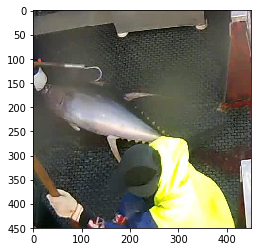

Original label:YFT, Prediction :OTHER, confidence : 0.877


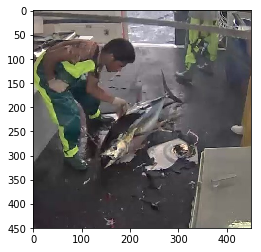

Original label:YFT, Prediction :OTHER, confidence : 0.520


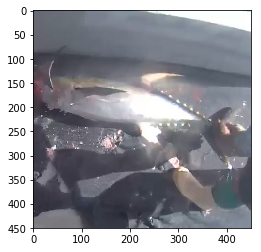

Original label:YFT, Prediction :SHARK, confidence : 0.909


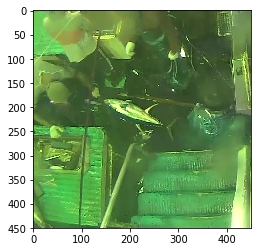

Original label:YFT, Prediction :BET, confidence : 0.607


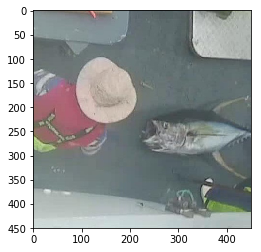

Original label:YFT, Prediction :ALB, confidence : 0.971


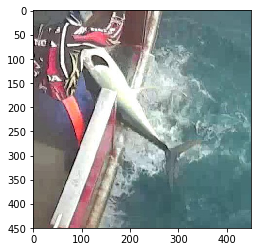

Original label:YFT, Prediction :ALB, confidence : 0.984


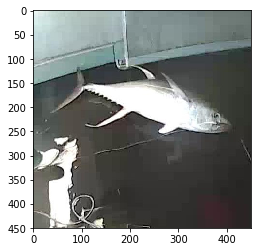

Original label:YFT, Prediction :ALB, confidence : 0.997


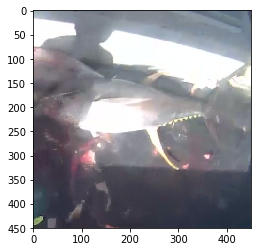

Original label:YFT, Prediction :OTHER, confidence : 0.982


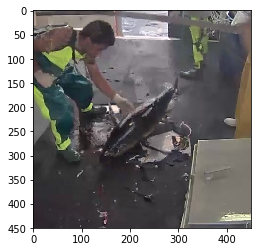

Original label:YFT, Prediction :ALB, confidence : 0.578


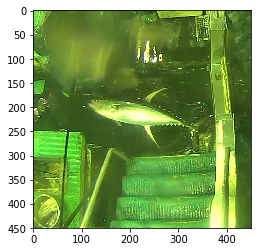

Original label:YFT, Prediction :ALB, confidence : 0.854


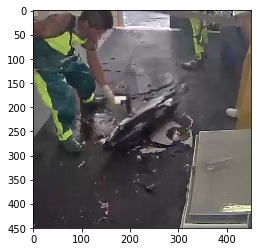

Original label:YFT, Prediction :ALB, confidence : 0.701


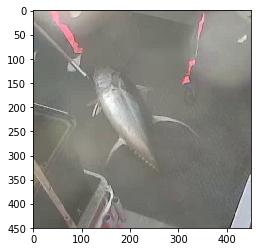

Original label:YFT, Prediction :ALB, confidence : 0.977


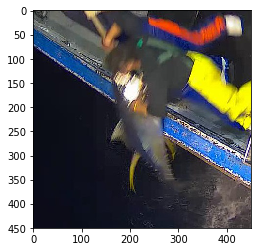

Original label:YFT, Prediction :ALB, confidence : 0.412


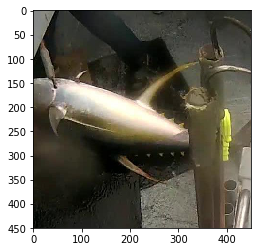

Original label:YFT, Prediction :DOL, confidence : 0.941


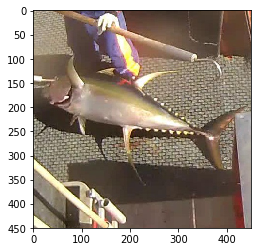

Original label:YFT, Prediction :ALB, confidence : 1.000


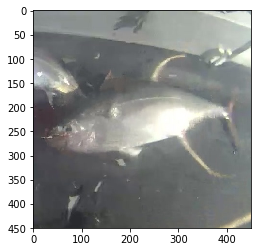

Original label:YFT, Prediction :ALB, confidence : 1.000


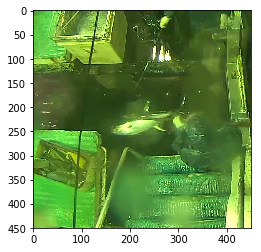

Original label:YFT, Prediction :OTHER, confidence : 0.675


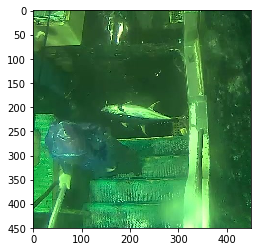

Original label:YFT, Prediction :ALB, confidence : 0.995


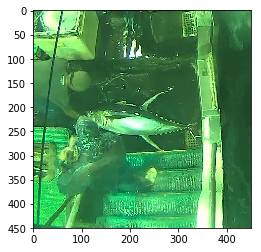

Original label:YFT, Prediction :ALB, confidence : 0.938


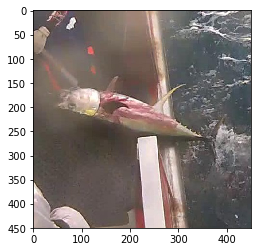

Original label:YFT, Prediction :DOL, confidence : 0.992


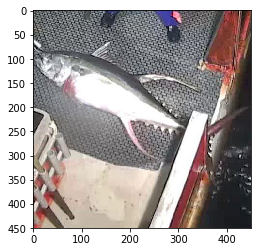

Original label:YFT, Prediction :OTHER, confidence : 0.473


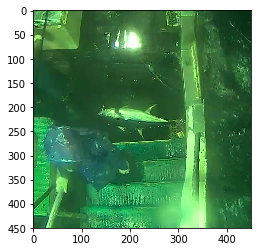

Original label:YFT, Prediction :ALB, confidence : 0.946


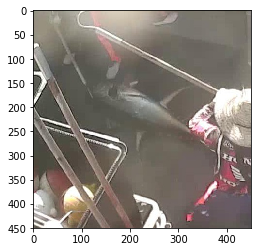

Original label:YFT, Prediction :ALB, confidence : 0.954


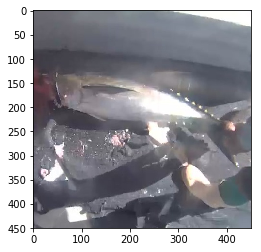

Original label:YFT, Prediction :ALB, confidence : 0.993


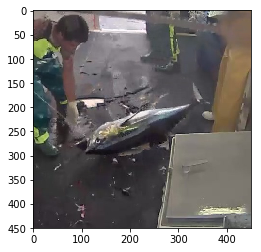

Original label:YFT, Prediction :OTHER, confidence : 0.852


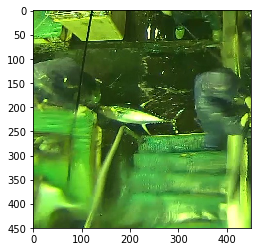

Original label:YFT, Prediction :ALB, confidence : 0.638


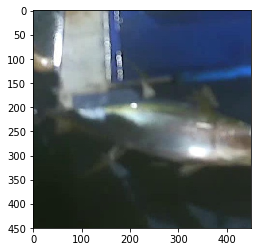

Original label:YFT, Prediction :SHARK, confidence : 0.746


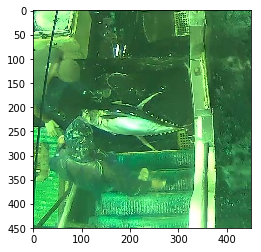

Original label:YFT, Prediction :ALB, confidence : 0.998


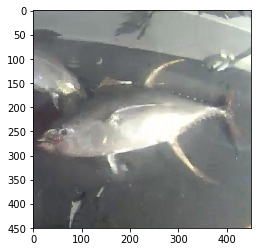

Original label:YFT, Prediction :BET, confidence : 0.940


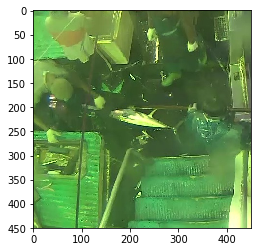

Original label:YFT, Prediction :OTHER, confidence : 0.508


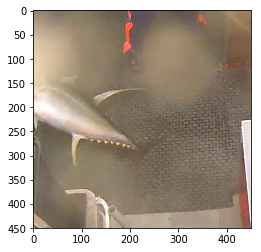

Original label:YFT, Prediction :ALB, confidence : 0.670


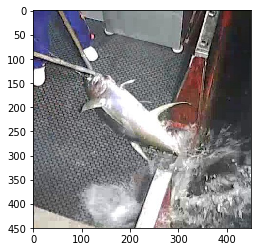

Original label:YFT, Prediction :OTHER, confidence : 0.465


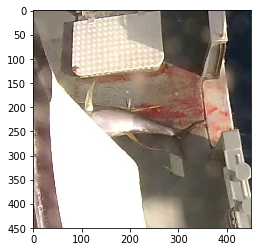

Original label:YFT, Prediction :ALB, confidence : 0.545


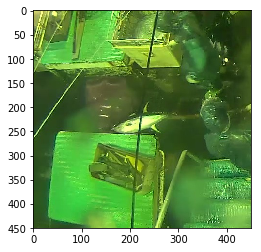

Original label:YFT, Prediction :DOL, confidence : 0.660


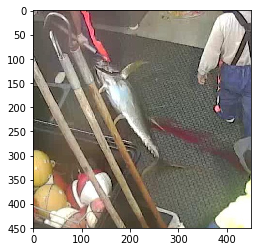

Original label:YFT, Prediction :ALB, confidence : 0.998


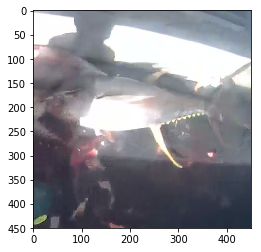

Original label:YFT, Prediction :ALB, confidence : 0.986


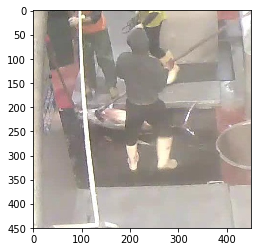

Original label:YFT, Prediction :ALB, confidence : 0.991


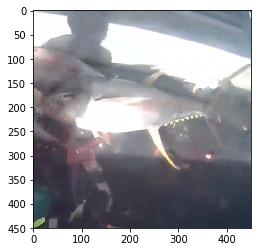

Original label:YFT, Prediction :OTHER, confidence : 0.999


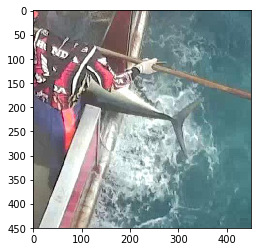

Original label:YFT, Prediction :ALB, confidence : 0.625


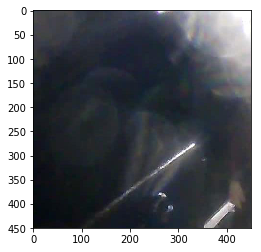

Original label:YFT, Prediction :OTHER, confidence : 1.000


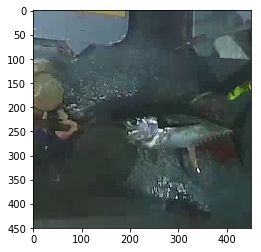

Original label:YFT, Prediction :ALB, confidence : 0.903


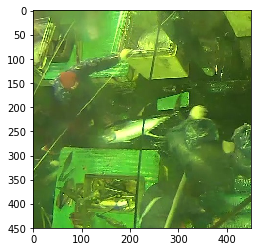

Original label:YFT, Prediction :ALB, confidence : 0.792


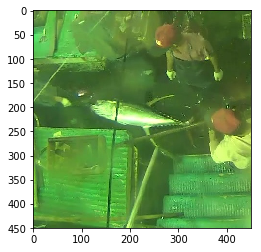

Original label:YFT, Prediction :ALB, confidence : 0.997


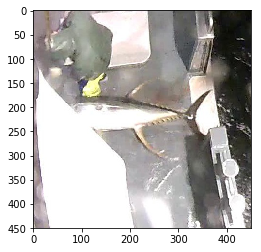

Original label:YFT, Prediction :ALB, confidence : 0.999


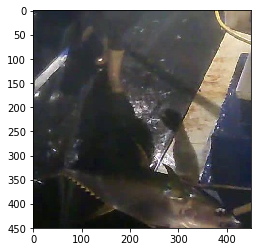

Original label:YFT, Prediction :ALB, confidence : 0.442


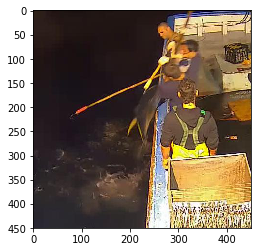

Original label:YFT, Prediction :ALB, confidence : 0.962


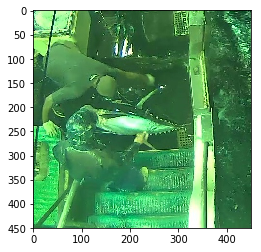

Original label:YFT, Prediction :DOL, confidence : 0.500


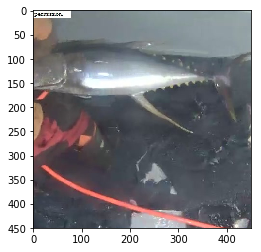

Original label:YFT, Prediction :ALB, confidence : 0.954


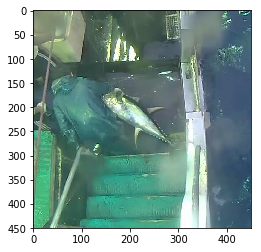

In [23]:
for i in range(len(errors)):
    pred_class = np.argmax(prob[errors[i]])
    pred_label = idx2label[pred_class]
    
    print('Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        prob[errors[i]][pred_class]))
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.imshow(original)
    plt.show()

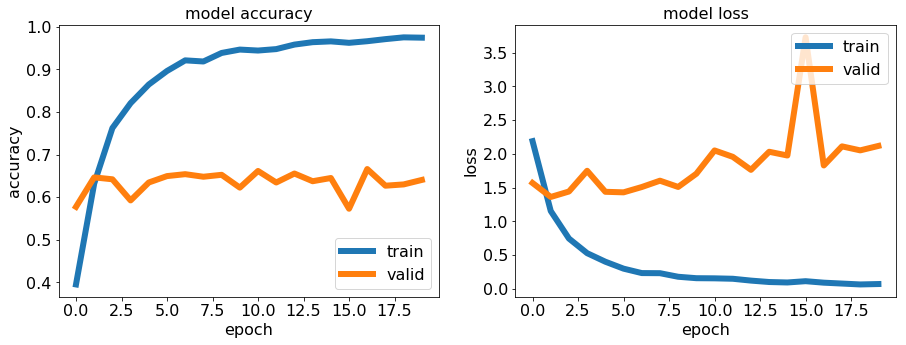

In [15]:
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['acc'],linewidth=6); plt.plot(history.history['val_acc'],linewidth=6);
plt.title('model accuracy',fontsize=16); plt.ylabel('accuracy',fontsize=16);
plt.xticks(fontsize=16);plt.yticks(fontsize=16);
plt.xlabel('epoch',fontsize=16); plt.legend(['train', 'valid'], loc='lower right',fontsize=16);

# summarize history for loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'],linewidth=6); plt.plot(history.history['val_loss'],linewidth=6);
plt.title('model loss',fontsize=16); plt.ylabel('loss',fontsize=16);
plt.xlabel('epoch',fontsize=16); plt.legend(['train', 'valid'], loc='upper right',fontsize=16);
plt.xticks(fontsize=16);plt.yticks(fontsize=16);
plt.show()

In [17]:
truth = np.where(predictions == ground_truth)[0]
print("No of true labels = {}/{}".format(len(truth),nVal))

No of true labels = 426/665


Original label:ALB, Prediction :ALB, confidence : 1.000


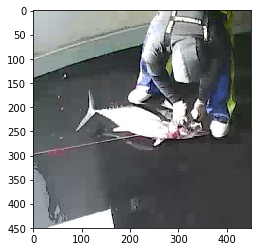

Original label:ALB, Prediction :ALB, confidence : 1.000


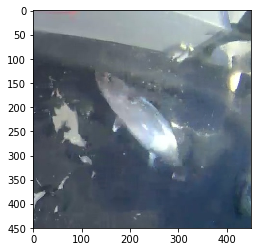

Original label:ALB, Prediction :ALB, confidence : 0.999


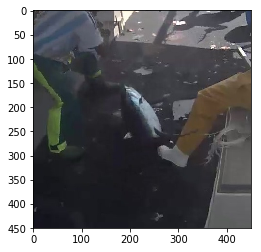

Original label:ALB, Prediction :ALB, confidence : 0.998


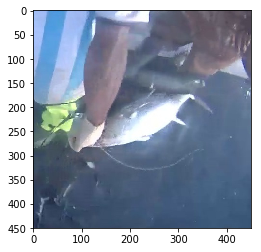

Original label:ALB, Prediction :ALB, confidence : 1.000


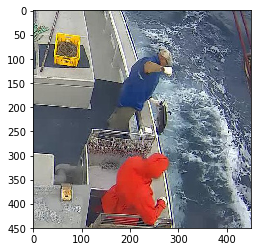

Original label:ALB, Prediction :ALB, confidence : 0.995


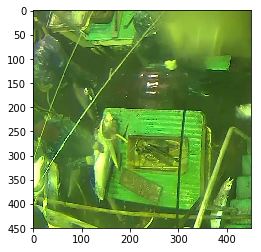

Original label:ALB, Prediction :ALB, confidence : 1.000


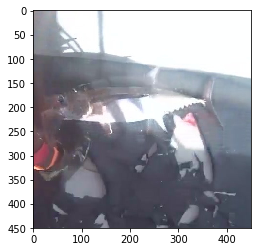

Original label:ALB, Prediction :ALB, confidence : 0.999


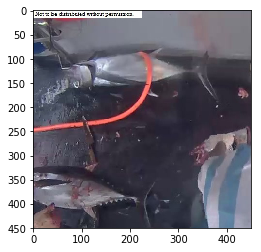

Original label:ALB, Prediction :ALB, confidence : 0.996


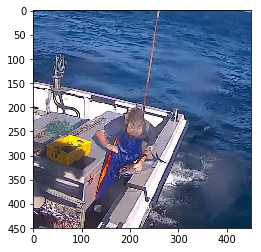

Original label:ALB, Prediction :ALB, confidence : 0.998


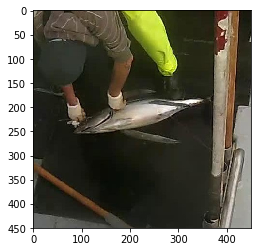

Original label:ALB, Prediction :ALB, confidence : 0.988


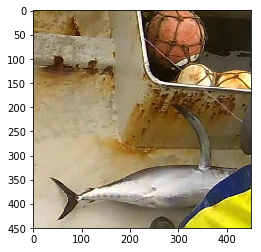

Original label:ALB, Prediction :ALB, confidence : 1.000


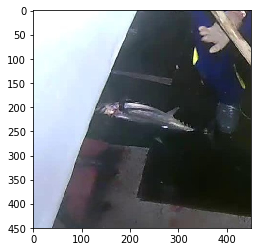

Original label:ALB, Prediction :ALB, confidence : 1.000


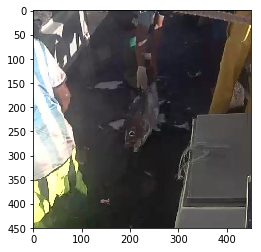

Original label:ALB, Prediction :ALB, confidence : 0.914


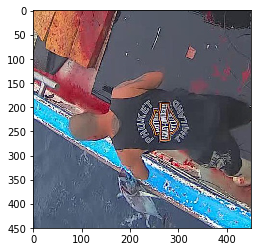

Original label:ALB, Prediction :ALB, confidence : 0.983


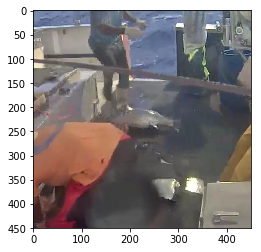

Original label:ALB, Prediction :ALB, confidence : 0.803


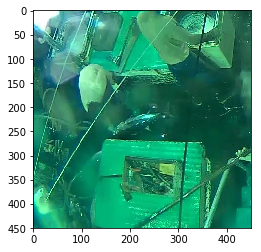

Original label:ALB, Prediction :ALB, confidence : 1.000


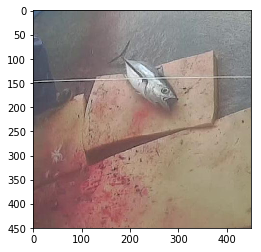

Original label:ALB, Prediction :ALB, confidence : 1.000


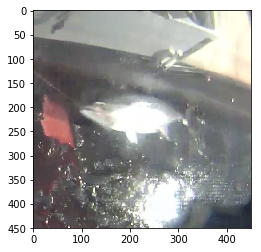

Original label:ALB, Prediction :ALB, confidence : 1.000


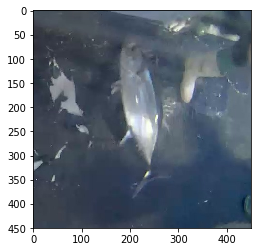

Original label:ALB, Prediction :ALB, confidence : 0.987


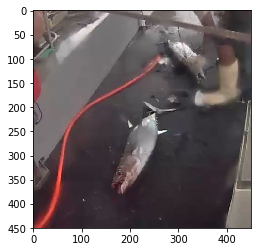

In [18]:
for i in range(50,70):
    pred_class = np.argmax(prob[truth[i]])
    pred_label = idx2label[pred_class]
    
    print('Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[truth[i]].split('/')[0],
        pred_label,
        prob[truth[i]][pred_class]))
    
    original = load_img('{}/{}'.format(validation_dir,fnames[truth[i]]))
    plt.imshow(original)
    plt.show()